## Datos de compresores de aire

#### Carga de datos

In [1]:
# DESDE MÓDULOS
from preprocesamiento import bases_de_datos as bbdd

# GENERALES
import pandas as pd
import numpy as np
import os
import random
from operator import itemgetter
from collections import Counter

# VISUALIZACIÓN
import matplotlib.pyplot as plt
import plotly.express as px

# MODELADO
import pickle
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
from catboost import CatBoostRegressor

# MongoDB
import pymongo

In [2]:
# Se carga todo en un único dataframe con una columna que indica el compresor
compresores = bbdd.carga_compresores()
compresores

,Presion,Temperatura,Frecuencia,Potencia_Medida,Potencia_Estimada,compresor
0,0.775748,16.9,0.000000,71.466562,77.432556,CompA
1,0.776315,16.6,0.000000,71.442768,77.498194,CompA
2,0.776784,16.6,0.000000,71.347653,77.477151,CompA
3,0.777093,16.4,0.000000,71.244807,77.524010,CompA
4,0.777436,16.4,0.000000,71.194101,77.508609,CompA
...,...,...,...,...,...,...
41784,0.747784,8.9,4.021267,78.700917,80.606028,CompD
41785,0.747565,8.9,4.006250,78.568766,80.613163,CompD
41786,0.747156,8.5,4.007903,78.495658,80.855701,CompD
41787,0.745775,8.5,4.012087,78.643818,80.988209,CompD


### Ingesta de datos crudos en MySQL

Se ha decidido crear una base de datos que contenga una tabla con datos de los cuatro compresores ya que estos no presentan relaciones entre sí.

In [3]:
credentials = bbdd.sql_connect()

In [4]:
bbdd.sql_create_db(credentials)

In [5]:
bbdd.sql_insert(compresores)

Comprobar que se ha subido correctamente.

In [6]:
bbdd.sql_consulta('''SELECT *  FROM compresores''', credentials)

c:\Users\yo\Desktop\0-BDatA\BDATA2\Reto8\preprocesamiento\bases_de_datos.py:130: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  resultado = pd.read_sql(consulta, conn)


,Presion,Temperatura,Frecuencia,Potencia_Medida,Potencia_Estimada,compresor


ANÁLISIS DESCRIPTIVO EN MYSQL

Media de cada variable por compresores

In [7]:
consulta = '''SELECT compresor, 
                        AVG(Presion) AS media_Presion, 
                        AVG(Temperatura) AS media_Temperatura, 
                        AVG(Frecuencia) AS media_Frecuencia, 
                        AVG(Potencia_estimada) as media_PotenciaEstimada
FROM compresores
GROUP BY compresor'''
bbdd.sql_consulta(consulta, credentials)

c:\Users\yo\Desktop\0-BDatA\BDATA2\Reto8\preprocesamiento\bases_de_datos.py:130: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  resultado = pd.read_sql(consulta, conn)


,compresor,media_Presion,media_Temperatura,media_Frecuencia,media_PotenciaEstimada


Máximos y mínimos de cada variable por compresores

In [8]:
consulta = '''SELECT compresor, 
                        MIN(Presion) AS min_Presion, 
                        MIN(Temperatura) AS min_Temperatura, 
                        MIN(Frecuencia) AS min_Frecuencia, 
                        MIN(Potencia_estimada) as min_PotenciaEstimada
FROM compresores
GROUP BY compresor'''
bbdd.sql_consulta(consulta, credentials)

c:\Users\yo\Desktop\0-BDatA\BDATA2\Reto8\preprocesamiento\bases_de_datos.py:130: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  resultado = pd.read_sql(consulta, conn)


,compresor,min_Presion,min_Temperatura,min_Frecuencia,min_PotenciaEstimada


In [9]:
consulta = '''SELECT compresor, 
                        MAX(Presion) AS max_Presion, 
                        MAX(Temperatura) AS max_Temperatura, 
                        MAX(Frecuencia) AS max_Frecuencia, 
                        MAX(Potencia_estimada) as max_PotenciaEstimada
FROM compresores
GROUP BY compresor'''
bbdd.sql_consulta(consulta, credentials)

c:\Users\yo\Desktop\0-BDatA\BDATA2\Reto8\preprocesamiento\bases_de_datos.py:130: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  resultado = pd.read_sql(consulta, conn)


,compresor,max_Presion,max_Temperatura,max_Frecuencia,max_PotenciaEstimada


### Missings, duplicados y outliers

Missings

In [10]:
# ¿Hay missings?
compresores.isna().sum()

Presion              0
Temperatura          0
Frecuencia           0
Potencia_Medida      0
Potencia_Estimada    0
compresor            0
dtype: int64

Duplicados

In [11]:
# Comprobar duplicados con MySQL
bbdd.sql_duplicados(credentials)

No se encontraron duplicados


In [12]:
# ¿Hay duplicados?
compresores.duplicated().sum()

# No los quitaremos, ya que puede ser que se haya dado la misma situación en dos momentos distintos,
# sobre todo si son próximos en el tiempo

# Duplicados por compresor (se añade una columna de si es duplicado primero)
compresores['duplicado'] = compresores.duplicated()
compresores[compresores['duplicado'] == True].groupby('compresor').count()

,Presion,Temperatura,Frecuencia,Potencia_Medida,Potencia_Estimada,duplicado
compresor,,,,,,
CompC,6,6,6,6,6,6
CompD,5,5,5,5,5,5


In [13]:
# Visualizar esos duplicados en un scatter plot de Presion vs Frecuencia, marcando los duplicados
fig = px.scatter(compresores, x='Frecuencia', y='Potencia_Medida', color='duplicado')
fig.update_layout(title='Frecuencia y potencia medida, marcando los duplicados',
                  xaxis_title='Frecuencia', yaxis_title='Potencia medida')
fig.show()

# Todos ellos tienen valores altos de potencia medida, pero no son máximos ni valores atípicos

Outliers

In [14]:
# ¿Hay outliers?
compresores.describe()

# La frecuencia va de 0 a 100 (es un porcentaje), por lo que no hay outliers
# La temperatura tiene valores negativos, pero pueden ser factibles
# En el resto de variables no hay valores que se salgan del rango esperado

,Presion,Temperatura,Frecuencia,Potencia_Medida,Potencia_Estimada
count,176781.000000,176781.000000,176781.000000,176781.000000,176781.000000
mean,0.760178,12.528239,24.113553,91.913766,92.026343
std,0.014557,6.461401,25.640780,20.653660,20.713235
min,0.727901,-5.400000,0.000000,50.394369,55.614709
25%,0.748172,7.900000,0.000000,74.887941,75.358058
50%,0.757743,12.100000,17.000000,86.138320,86.609357
75%,0.767126,16.600000,40.000000,108.978045,107.111876
max,0.817415,39.000000,100.000000,132.000000,132.000000


### Análisis exploratorio

In [27]:
# Instancias con frecuencia 10<x<90 vs resto
frecuencia_10_90 = compresores['Frecuencia'].apply(lambda x: 1 if 10 < x < 90 else 0)
Counter(frecuencia_10_90)[1] / (Counter(frecuencia_10_90)[0] + Counter(frecuencia_10_90)[1])

0.5550766202250241

In [28]:
# Datos por compresor
frecuencias = compresores['compresor'].value_counts()

fig = px.bar(frecuencias, x=frecuencias.index, y=frecuencias)
fig.update_layout(title='Cantidad de filas por compresor', xaxis_title='Compresor', yaxis_title='Frecuencia',
                  width=800, height=500)
fig.show()

In [29]:
# Media de todas las columnas por compresor
compresores.groupby('compresor').mean()

,Presion,Temperatura,Frecuencia,Potencia_Medida,Potencia_Estimada,duplicado
compresor,,,,,,
CompA,0.770542,11.936001,18.072116,90.796443,90.945048,0.000000
CompB,0.756487,12.457936,24.500749,88.683290,88.779733,0.000000
CompC,0.755801,12.788935,26.707291,92.493392,92.631959,0.000121
CompD,0.759691,12.852751,26.287229,95.829053,95.894564,0.000120


In [30]:
# Scatterplot de Presion y Temperatura por compresor
fig = px.scatter(compresores, x='Temperatura', y='Presion', color='compresor')
fig.update_layout(title='Temperatura y presión por compresor', xaxis_title='Temperatura', yaxis_title='Presión',
                    width=800, height=500)  
fig.add_annotation(x=10, y=0.82, text='Valores altos de Presión --> Compresor A', showarrow=False, font=dict(color='black', size=14))
fig.add_annotation(x=25, y=0.73, text='Valores altos de Temperatura --> Compresores B y C', showarrow=False, font=dict(color='black', size=14))
fig.show()

# Los valores más altos de Presión (por encima de 0,79) se dan en el compresor A,
# y cuando la temperatura es más alta se observan algunas observaciones de los compresores B y C.

In [31]:
# Scatterplot de Frecuencia y Potencia_Medida por compresor
fig = px.scatter(compresores, x='Frecuencia', y='Potencia_Medida', color='compresor')
fig.update_layout(title='Frecuencia y potencia medida por compresor', xaxis_title='Frecuencia', yaxis_title='Potencia medida',
                    width=800, height=500)
fig.show()

# El compresor D tiene valores ligeramente más altos de potencia que el resto (95,83 de media frente a 88, 90 y 92 de los otros tres)

### MongoDB (parte 1/2: inicialización)

In [32]:
cliente = bbdd.mongo_connect()

In [33]:
db, colec_regr, colec_opt = bbdd.mongo_create_db(cliente)

In [34]:
print(db.list_collection_names()) # como no se ha insertado nada, todavía no aparecen las colecciones

[]


### Modelos de regresión

In [35]:
# Crear carpeta modelos si no existe
if not os.path.exists('Modelos'):
    os.makedirs('Modelos')

In [36]:
# Regression to predict Potencia_Medida with Catboost, cv=5 and scoring='neg_mean_squared_error'

def train_and_validate(compressor:str, compresores:pd.DataFrame) -> dict:
    """Regresión con Catboost para predecir la potencia medida de un compresor, con validación cruzada de 5 folds y siendo el scoring el neg_mean_squared_error.
    Primero, se seleccionan las variables que se van a emplear en el modelo, y se separan los datos en train y test.
    Después, se entrena el modelo con los datos de train y se valida con los datos de test.
    Se almacenan ambas métricas, así como las importancias de las variables. Se devuelve un diccionario con los indicadores más importantes.

    Args:
        compressor (str): Nombre del compresor
        compresores (pd.DataFrame): DataFrame con los datos de los compresores

    Returns:
        model_info (dict): Diccionario con los indicadores más importantes del modelo
    """
    feature_columns = ['Presion', 'Temperatura', 'Frecuencia']
    target_column = 'Potencia_Medida'

    data = compresores[compresores['compresor'] == compressor]
    
    X = data[feature_columns]
    y = data[target_column]

    # Separación de los datos en train y test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

    # Entrenamiento del modelo
    model = CatBoostRegressor(verbose=1000)
    model.fit(X_train, y_train)

    # Validación del modelo con los datos de test
    y_pred = model.predict(X_test)
    r2 = r2_score(y_test, y_pred)
    print('R2 en test:', r2.round(4))
    error_traintest = mean_squared_error(y_test, y_pred)
    print('MSE en test:', error_traintest.round(4))

    # Comparar con el modelo baseline: Potencia_Estimada
    y_pred_baseline = data['Potencia_Estimada']
    r2_baseline = r2_score(y, y_pred_baseline)
    print('R2 baseline:', r2_baseline.round(4))
    error_baseline = mean_squared_error(y, y_pred_baseline)
    print('MSE baseline:', error_baseline.round(4))

    # Guardado del modelo y las métricas de validación
    pickle.dump(model, open(f'Modelos/compresor_{compressor}.pkl', 'wb'))
    print(f'Modelo del compresor {compressor} guardado en la carpeta Modelos.')
    feature_importances_dict = dict(zip(feature_columns, model.feature_importances_))
    model_info = {
        'model_params': model.get_params(),
        'feature_importances': feature_importances_dict,
        'metrics': {
            'r2': r2,
            'r2_baseline': r2_baseline,
            'error_traintest': error_traintest,
            'error_baseline': error_baseline,
        }
    }
    return model_info

In [37]:
# Se aplica la función a todos los compresores y se guardan modelos y métricas en un diccionario
for compressor in compresores['compresor'].unique():
    model_info = train_and_validate(compressor, compresores)
    model_info['compressor'] = compressor
    try:
        colec_regr.insert_one(model_info)
        print(f'Documento del compresor {compressor} insertado correctamente en MongoDB.')
    except pymongo.errors.DuplicateKeyError as error:
        print('Ya existe ese documento.')

Learning rate set to 0.069886
0:	learn: 14.4728557	total: 169ms	remaining: 2m 48s
999:	learn: 1.6935190	total: 11.6s	remaining: 0us
R2 en test: 0.9871
MSE en test: 3.1977
R2 baseline: 0.973
MSE baseline: 6.5328
Modelo del compresor CompA guardado en la carpeta Modelos.
Documento del compresor CompA insertado correctamente en MongoDB.
Learning rate set to 0.071631
0:	learn: 20.6221248	total: 7.49ms	remaining: 7.49s
999:	learn: 1.4873590	total: 14.6s	remaining: 0us
R2 en test: 0.9948
MSE en test: 2.5233
R2 baseline: 0.9875
MSE baseline: 6.0849
Modelo del compresor CompB guardado en la carpeta Modelos.
Documento del compresor CompB insertado correctamente en MongoDB.
Learning rate set to 0.072522
0:	learn: 20.1800131	total: 12.6ms	remaining: 12.6s
999:	learn: 1.6761607	total: 20s	remaining: 0us
R2 en test: 0.9935
MSE en test: 3.1248
R2 baseline: 0.986
MSE baseline: 6.6238
Modelo del compresor CompC guardado en la carpeta Modelos.
Documento del compresor CompC insertado correctamente en Mo

In [38]:
# Visualizar resultados
results = pd.DataFrame()
for compressor in compresores['compresor'].unique():
    model_info = colec_regr.find_one({'compressor': compressor})
    results = pd.concat([results, pd.DataFrame(model_info['metrics'], index=[compressor])], axis=0)
results

,r2,r2_baseline,error_traintest,error_baseline
CompA,0.987058,0.973022,3.197674,6.532841
CompB,0.994812,0.987548,2.523313,6.084914
CompC,0.993483,0.985966,3.124833,6.623844
CompD,0.994157,0.987685,2.610261,5.534612


In [39]:
# Sacar feature importances
feature_importances = pd.DataFrame()
for compressor in compresores['compresor'].unique():
    model_info = colec_regr.find_one({'compressor': compressor})
    feature_importances = pd.concat([feature_importances, pd.DataFrame(model_info['feature_importances'], index=[compressor])], axis=0)
feature_importances

,Presion,Temperatura,Frecuencia
CompA,7.799411,11.207879,80.992710
CompB,2.242515,7.427759,90.329726
CompC,2.179711,8.357452,89.462837
CompD,2.940283,10.562055,86.497662


### Optimización

In [ ]:
N_INDIVIDUOS = 50
N_GENERATIONS = 400
MUTATION_RATE = 0.2
CROSSOVER_RATE = 0.5

PRODUCCION = np.array([100, 90, 95, 110])
CONSUMO_TEORICO = np.array([120, 125, 130, 130]) # el real se predecirá con el mejor modelo de regresión

# Definir el caudal mínimo requerido
MIN_PRODUCCION = 250

In [ ]:
def simulate_presion():
    """Función que simula la presión de los compresores, siguiendo la misma distribución que la real.
    """
    mean = compresores['Presion'].mean()
    std = compresores['Presion'].std()
    return np.random.normal(mean, std)

def simulate_temperatura():
    """Función que simula la temperatura de los compresores, siguiendo la misma distribución que la real.
    """
    mean = compresores['Temperatura'].mean()
    std = compresores['Temperatura'].std()
    return np.random.normal(mean, std)

In [ ]:
modeloA = pickle.load(open(f'Modelos/compresor_CompA.pkl', 'rb'))
modeloB = pickle.load(open(f'Modelos/compresor_CompB.pkl', 'rb'))
modeloC = pickle.load(open(f'Modelos/compresor_CompC.pkl', 'rb'))
modeloD = pickle.load(open(f'Modelos/compresor_CompD.pkl', 'rb'))

modelos = {
    'CompA': modeloA,
    'CompB': modeloB,
    'CompC': modeloC,
    'CompD': modeloD
}

In [ ]:
def predecir_potencia(compressor, individual, modelos=modelos):
    """Función que predice la potencia medida de un compresor a partir de un modelo y un array con los valores de Presión, Temperatura y Frecuencia.

    Args:
        compressor (str): Nombre del compresor que será cargado con Pickle
        individual (array): Array con los valores de Presión, Temperatura y Frecuencia
        modelos (dict): Diccionario con los modelos de regresión de cada compresor

    Returns:
        pred (float): Valor de la potencia medida predicha (el consumo)
    """
    # Cargar modelos con pickle
    modelo = modelos[compressor]
    pres = simulate_presion()
    temp = simulate_temperatura()
    dict_relaciones = {'CompA': 0, 'CompB': 1, 'CompC': 2, 'CompD': 3}
    frec = individual[dict_relaciones[compressor]]

    # Predecir la potencia medida
    df_pred = pd.DataFrame({'Presion': pres, 'Temperatura': temp, 'Frecuencia': frec}, index=[0])
    pred = modelo.predict(df_pred)[0]
    return pred

#### Población inicial

In [ ]:
def poblacion_inicial(N_INDIVIDUOS, PRODUCCION, MIN_PRODUCCION, N_COMPRESORES=4):
    """Genera una población inicial de individuos con valores aleatorios entre 30 y 85 (evitando penalizaciones).
    En total deben tener una producción mínima de min_produccion, teniendo que cuenta que:
    produccion total = sumatorio de frecuencia*produccion de cada compresor

    Args:
        N_INDIVIDUOS (int): número de individuos de la población
        PRODUCCION (array): producción de cada compresor con una frecuencia del 100%
        MIN_PRODUCCION (int): producción mínima requerida
        N_COMPRESORES (int, optional): número de compresores. Por defecto son 4.

    Returns:
        poblacion (list): lista de individuos
    """
    poblacion = []
    while len(poblacion) < N_INDIVIDUOS:
        individuo = np.random.randint(30, 85, N_COMPRESORES)
        individuo = [float(i) for i in individuo]
        caudal = PRODUCCION * individuo/100
        if sum(caudal) >= MIN_PRODUCCION:
            poblacion.append(individuo)
    return poblacion

In [ ]:
poblacion = poblacion_inicial(N_INDIVIDUOS, PRODUCCION, MIN_PRODUCCION)
poblacion

[[79.0, 79.0, 61.0, 68.0],
 [63.0, 63.0, 72.0, 60.0],
 [59.0, 65.0, 72.0, 76.0],
 [84.0, 68.0, 59.0, 81.0],
 [83.0, 67.0, 51.0, 67.0],
 [70.0, 64.0, 83.0, 76.0],
 [53.0, 58.0, 80.0, 76.0],
 [64.0, 81.0, 56.0, 70.0],
 [71.0, 77.0, 46.0, 78.0],
 [81.0, 76.0, 60.0, 62.0],
 [49.0, 55.0, 70.0, 84.0],
 [71.0, 47.0, 70.0, 84.0],
 [65.0, 67.0, 84.0, 79.0],
 [51.0, 75.0, 67.0, 81.0],
 [83.0, 65.0, 62.0, 66.0],
 [83.0, 47.0, 63.0, 67.0],
 [76.0, 50.0, 79.0, 57.0],
 [75.0, 56.0, 84.0, 83.0],
 [67.0, 69.0, 48.0, 72.0],
 [71.0, 62.0, 79.0, 69.0],
 [39.0, 84.0, 74.0, 72.0],
 [72.0, 58.0, 64.0, 66.0],
 [83.0, 70.0, 74.0, 60.0],
 [79.0, 76.0, 64.0, 45.0],
 [70.0, 52.0, 74.0, 72.0],
 [69.0, 77.0, 69.0, 48.0],
 [76.0, 60.0, 81.0, 62.0],
 [75.0, 62.0, 31.0, 82.0],
 [72.0, 84.0, 43.0, 59.0],
 [71.0, 35.0, 68.0, 78.0],
 [79.0, 72.0, 66.0, 72.0],
 [81.0, 63.0, 80.0, 50.0],
 [60.0, 78.0, 65.0, 75.0],
 [53.0, 68.0, 84.0, 66.0],
 [75.0, 75.0, 68.0, 68.0],
 [52.0, 80.0, 60.0, 75.0],
 [56.0, 66.0, 62.0, 82.0],
 

#### Fitness y penalty functions

In [ ]:
# Crear carpeta gráficos si no existe
if not os.path.exists('Graficos'):
    os.makedirs('Graficos')

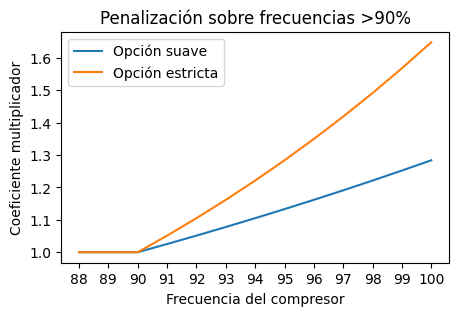

In [ ]:
compr = range(88, 101)

nums = []
for c in compr:
    nums.append(max(1, np.exp((c-90)/40)))

nums2 = []
for c in compr:
    nums2.append(max(1, np.exp((c-90)/20)))

plt.figure(figsize=(5, 3))
plt.plot(compr, nums, label='Opción suave')
plt.plot(compr, nums2, label='Opción estricta')
plt.xticks(compr) # x-axis labels
plt.xlabel('Frecuencia del compresor')
plt.ylabel('Coeficiente multiplicador')
plt.legend()
plt.title('Penalización sobre frecuencias >90%')
plt.savefig('Graficos/penalizacion_90.png', dpi=300, bbox_inches='tight')
plt.show()

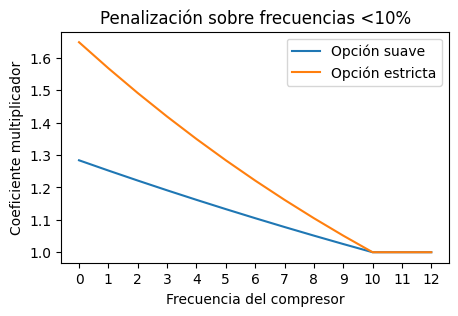

In [ ]:
compr = range(0, 13)

nums = []
for c in compr:
    nums.append(max(1, np.exp((10-c)/40)))

nums2 = []
for c in compr:
    nums2.append(max(1, np.exp((10-c)/20)))

plt.figure(figsize=(5, 3))
plt.plot(compr, nums, label='Opción suave')
plt.plot(compr, nums2, label='Opción estricta')
plt.xticks(compr) # x-axis labels
plt.xlabel('Frecuencia del compresor')
plt.ylabel('Coeficiente multiplicador')
plt.legend()
plt.title('Penalización sobre frecuencias <10%')
plt.savefig('Graficos/penalizacion_10.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
# La función de fitness devuelve el consumo de la solución tras aplicar varias penalizaciones

def fitness(individual, min_produccion):
    compresores_tipos = ['CompA', 'CompB', 'CompC', 'CompD']
    consumo = np.array([predecir_potencia(compressor=c, individual=individual) for c in compresores_tipos])
    consumo = np.sum(consumo) # consumo total de la solución
    caudal = np.sum(individual * PRODUCCION / 100) # caudal total de la solución
    
    # Penalizaciones:
    # - Si frecuencia > 90 --> función de penalización exponencial estricta: consumo*max(1,e^((x-90)/20))
    for compr in individual:
        consumo *= max(1, np.exp((compr-90)/20))
    # - Si frecuencia es 0 o se acerca --> función de penalización exponencial suave: consumo*max(1,e^((10-x)/40))
    for compr in individual:
        consumo *= max(1, np.exp((10-compr)/40))

    # Si el caudal total es menor que el mínimo requerido, también se penaliza
    if caudal < min_produccion:
        consumo *= 1 + (min_produccion - caudal) / 500 # con consumo=320, min_produccion=250 y produccion=245 --> consumo=320*1.01=323.2

    # Se crea una columna de si es feasible o no
    individual = np.array(individual)
    individual_feasible = np.logical_and(individual >= 10, individual <= 90).all()
    produccion_feasible = caudal >= min_produccion
    feasible = individual_feasible and produccion_feasible

    return consumo, feasible, caudal

In [ ]:
# Dato teórico aproximado
compresores[(compresores['Frecuencia'] > 70) & (compresores['Frecuencia'] < 80)]['Potencia_Medida'].mean()*4

513.6910515056449

In [ ]:
# Datos reales
fitness([70,80,70,80], MIN_PRODUCCION)

(513.0830075349181, True, 296.5)

In [ ]:
individuo1 = [90,30,90,30]
individuo2 = [91,30,91,30]
individuo3 = [95,30,95,30]
individuo4 = [90,8,90,8]
individuo5 = [90,5,90,5]
individuos = [individuo1, individuo2, individuo3, individuo4, individuo5]

# Sin caudal mínimo
fitness1 = [fitness(individuo, 1)[0] for individuo in individuos]
penalizaciones = pd.DataFrame({'Individuo': [individuo1, individuo2, individuo3, individuo4, individuo5],
                               'Caudal': [fitness(individuo, 1)[2] for individuo in individuos],
                               'Consumo (sin caudal mínimo)': fitness1,
                               'Feasible': [fitness(individuo, 1)[1] for individuo in individuos]})
penalizaciones

,Individuo,Caudal,Consumo (sin caudal mínimo),Feasible
0,"[90, 30, 90, 30]",235.50,444.377990,True
1,"[91, 30, 91, 30]",237.45,493.896313,False
2,"[95, 30, 95, 30]",245.25,730.702293,False
3,"[90, 8, 90, 8]",191.50,457.019492,False
4,"[90, 5, 90, 5]",185.50,515.686060,False


In [ ]:
# Con caudal mínimo
fitness2 = [fitness(individuo, MIN_PRODUCCION)[0] for individuo in individuos]
penalizaciones = pd.DataFrame({'Individuo': [individuo1, individuo2, individuo3, individuo4, individuo5],
                                'Caudal': [fitness(individuo, MIN_PRODUCCION)[2] for individuo in individuos],
                                'Consumo (con caudal mínimo = 250)': fitness2,
                                'Feasible': [fitness(individuo, MIN_PRODUCCION)[1] for individuo in individuos],
                                'Penalización por caudal': np.array(fitness2) - np.array(fitness1)})
penalizaciones

,Individuo,Caudal,Consumo (con caudal mínimo = 250),Feasible,Penalización por caudal
0,"[90, 30, 90, 30]",235.50,453.695818,False,9.317828
1,"[91, 30, 91, 30]",237.45,511.113550,False,17.217237
2,"[95, 30, 95, 30]",245.25,743.931219,False,13.228927
3,"[90, 8, 90, 8]",191.50,502.995194,False,45.975702
4,"[90, 5, 90, 5]",185.50,585.471643,False,69.785583


#### Selección de padres

In [ ]:
def rank_population(population):
    return sorted(population, key=itemgetter(0))

# Se usará rank selection para seleccionar los padres ya que los valores de fitness son cercanos
def rank_selection(ranked_population):
    # Asigna una ponderación de rango a cada individuo (cuanto menor sea el índice, mayor será la ponderación)
    for i in range(len(ranked_population)):
        ranked_population[i][0] = (len(ranked_population) - i) ** 2

    # Calcula las probabilidades teniendo en cuenta la ponderación del rango
    total = sum([ranked_population[i][0] for i in range(len(ranked_population))])
    probabilities = [ranked_population[i][0] / total for i in range(len(ranked_population))]

    # Calcula las probabilidades acumulativas
    cumulative_probabilities = np.cumsum(probabilities)

    # Genera un número aleatorio y selecciona el individuo correspondiente
    alpha = random.random()
    selected_index = np.where(alpha <= cumulative_probabilities)[0][0]

    return ranked_population[selected_index]

In [ ]:
def test_rank_selection(ranked_population, num_trials):
    # Inicializa un diccionario para rastrear cuántas veces se selecciona cada individuo
    selection_counts = {i: 0 for i in range(len(ranked_population))}

    for _ in range(num_trials):
        selected_individual = rank_selection(ranked_population)
        # Incrementa el contador para el individuo seleccionado
        selection_counts[ranked_population.index(selected_individual)] += 1

    return selection_counts

population = [[fitness(individual, MIN_PRODUCCION)[0], individual] for individual in poblacion]
ranked_population = rank_population(population)
print(ranked_population)

# Prueba la selección por rango 10000 veces
selection_counts = test_rank_selection(ranked_population, 10000)

# Muestra los resultados
for i in selection_counts:
    print(f'Individual {ranked_population[i][1]} at rank {i+1} (fitness: {ranked_population[i][0]}): selected {selection_counts[i]} times.')

[[475.30929402205606, [80.0, 54.0, 53.0, 70.0]], [477.66442371122014, [75.0, 59.0, 80.0, 42.0]], [482.6031802004712, [79.0, 84.0, 45.0, 53.0]], [482.66875535010445, [69.0, 58.0, 80.0, 52.0]], [487.3380608656042, [78.0, 47.0, 68.0, 79.0]], [487.41794556569215, [58.0, 82.0, 59.0, 58.0]], [487.5498051461569, [78.0, 46.0, 70.0, 80.0]], [488.6950815303936, [75.0, 40.0, 64.0, 76.0]], [489.2622912698221, [72.0, 59.0, 49.0, 82.0]], [489.8772185668659, [63.0, 69.0, 52.0, 71.0]], [490.0267051668057, [67.0, 62.0, 49.0, 75.0]], [490.2128375381375, [70.0, 76.0, 48.0, 61.0]], [490.8111812857651, [80.0, 73.0, 61.0, 52.0]], [491.1343490048396, [82.0, 33.0, 67.0, 68.0]], [491.6329631168582, [57.0, 80.0, 82.0, 45.0]], [491.68064609475056, [51.0, 73.0, 71.0, 63.0]], [492.0524113453039, [69.0, 69.0, 77.0, 49.0]], [492.81991512184453, [84.0, 84.0, 45.0, 70.0]], [493.14130007430657, [55.0, 49.0, 74.0, 77.0]], [494.9640418014802, [72.0, 73.0, 83.0, 40.0]], [495.67316272085236, [45.0, 57.0, 82.0, 75.0]], [496

In [ ]:
population = [[fitness(individual, MIN_PRODUCCION)[0], individual] for individual in poblacion]
ranked_population = rank_population(population)
print(f'Población ordenada: \n{ranked_population}')

parent1, parent2 = [rank_selection(ranked_population)[1] for _ in range(2)]
print(f'Padre 1: {parent1}')
print(f'Padre 2: {parent2}')

Población ordenada: 
[[471.64908601596204, [65.0, 34.0, 69.0, 81.0]], [475.17079971062327, [73.0, 81.0, 37.0, 76.0]], [481.8990133440793, [54.0, 79.0, 53.0, 72.0]], [482.7651904436604, [83.0, 64.0, 58.0, 62.0]], [483.2987808869964, [81.0, 39.0, 66.0, 71.0]], [483.5018646862569, [31.0, 74.0, 69.0, 82.0]], [483.54341710132064, [67.0, 47.0, 81.0, 59.0]], [484.1291836522256, [71.0, 42.0, 56.0, 82.0]], [485.7436252264896, [82.0, 32.0, 68.0, 71.0]], [486.89097583272155, [77.0, 83.0, 68.0, 35.0]], [487.3760062186374, [77.0, 43.0, 69.0, 68.0]], [489.3634820573418, [72.0, 83.0, 38.0, 72.0]], [490.08460478884996, [84.0, 76.0, 45.0, 62.0]], [490.5203681702917, [64.0, 76.0, 45.0, 73.0]], [491.71669743549046, [46.0, 83.0, 65.0, 73.0]], [492.23294514224347, [80.0, 80.0, 47.0, 78.0]], [493.1504022143821, [81.0, 76.0, 71.0, 41.0]], [493.86489629523345, [84.0, 60.0, 53.0, 59.0]], [494.1576387947729, [65.0, 79.0, 68.0, 45.0]], [494.4044152570834, [65.0, 54.0, 83.0, 61.0]], [495.1172565066471, [39.0, 82.

#### Crossover y mutation

In [ ]:
# El método de cruce es el Arithmetic Crossover
def crossover(parent1, parent2):
    if random.random() < CROSSOVER_RATE:
        alpha = random.random()
        child1 = [alpha*a + (1-alpha)*b for a, b in zip(parent1, parent2)]
        child2 = [alpha*b + (1-alpha)*a for a, b in zip(parent1, parent2)]
        return child1, child2
    else:
        return parent1.copy(), parent2.copy()

# Este método de cruce genera hijos que son una combinación lineal de sus padres.
# alpha es un número aleatorio entre 0 y 1 que decide cuánto de cada padre va a cada hijo.
# Si alpha es cercano a 0, el primer hijo será muy similar al segundo padre (y viceversa para el segundo hijo).
# Si alpha es cercano a 1, sucede lo contrario. Si alpha es 0.5, los hijos serán aproximadamente la media de los padres.

In [ ]:
# El método de mutación es añadir una variación aleatoria a un gen (una frecuencia de un compresor)
def mutation(individual, mutation_scale):
    for i in range(len(individual)):
        if random.random() < MUTATION_RATE:
            individual[i] += random.uniform(0, mutation_scale) # suma una variación aleatoria a un gen
    return individual

# mutation_scale es un parámetro que controla la magnitud de las mutaciones, el porcentaje de variación, y su rango se mueve entre 0 y 100.
# Por ejemplo, si los valores varían entre 0 y 100, se podría empezar con un mutation_scale de 1.5, que corresponde al 1,5% del rango total.

#### Differential evolution

In [ ]:
# RAND2BIN
def rand2bin(population, F=1, CR=0.4): # 0<F<2, 0.2<CR<1
    """Aplica el algoritmo de evolución diferencial rand/2/bin a una población:
    Rand significa que los vectores de mutación se generan de forma aleatoria.
    El 2 se debe a que se usan 2 vectores de mutación para generar el vector de prueba (4 individuos en total).
    Bin significa que se usa un cruce binomial discreto para generar el vector de prueba, es decir,
    se elige cada gen del vector de prueba de forma aleatoria entre el vector de mutación y el vector objetivo.

    Args:
        population (list): List of lists, each inner list is an individual.
        F (float, optional): Mutation factor. Por defecto es 1, y debe tomar valores entre 0 y 2.
            Representa la magnitud de la mutación. Cuanto mayor sea, mayor será la diferencia entre "y" y "x".
        CR (float, optional): Crossover rate. Por defecto es 0.4, y debe tomar valores entre 0 y 1.
            Representa el número de veces en las que se elige v (la mutación) en vez de x (el original).
            Se suele poner bajo para que x salga más veces.

    Returns:
        y (array): Individuo mutado, con componentes de los vectores x y v.

    """
    # Se seleccionan 6 individuos random de la población
    sample = random.sample(population, 6)

    # Se ordenan los individuos de menor a mayor fitness (ya que es minimización)
    ranked_sample = rank_population(sample)

    # Se saca el vector v y después se hace el bin entre v y x sobre y
    indivs = np.array([indiv[1] for indiv in ranked_sample])
    x, r1, r2, r3, r4, r5 = indivs
    v = r1 + F*(r2-r3) + F*(r4-r5)

    U = [random.random() for i in range(4)]
    y = x.copy()
    for i in range(len(v)):
        if U[i] < CR:
            y[i] = v[i] # en y (individuo mutado) se sustituye el valor inicial (x) por el valor mutado (v)

    return y

In [ ]:
generados = []
while len(generados) < N_INDIVIDUOS:
    individuo = rand2bin(population)
    fitness_value = fitness(individuo, MIN_PRODUCCION)[0]
    generados.append((fitness_value, individuo))
ranked_generados = rank_population(generados)
ranked_generados

[(480.3523556407825, array([72., 21., 66., 72.])),
 (483.0644572309094, array([80., 48., 56., 60.])),
 (485.4966778055646, array([60., 52., 76., 72.])),
 (486.4430425463484, array([83., 56., 63., 46.])),
 (490.3851298207899, array([56., 62., 77., 38.])),
 (491.9679027534613, array([67., 52., 76., 75.])),
 (492.02899226515825, array([72., 29., 66., 72.])),
 (493.3836384716773, array([74., 74., 68., 51.])),
 (495.16821072557366, array([67., 52., 76., 66.])),
 (496.28340003602784, array([65., 77., 56., 85.])),
 (500.1235398390234, array([65., 58., 64., 74.])),
 (500.4597121739387, array([73., 58., 64., 74.])),
 (501.1742249603722, array([42., 56., 74., 67.])),
 (502.8964033212376, array([43., 66., 71., 84.])),
 (503.36068841767155, array([74., 81., 55., 71.])),
 (503.7177675127567, array([61., 58., 81., 77.])),
 (504.76599887142527, array([23., 61., 64., 78.])),
 (504.88792317379654, array([70., 62., 77., 84.])),
 (505.54588234933993, array([77., 64., 67., 83.])),
 (505.57083750185143, ar

#### Evolucionar la población

In [ ]:
def evolve(poblacion, MIN_PRODUCCION, MUTATION_RATE):

    # El mutation_rate varía en función del porcentaje de copias
    porcentaje_copias = ((sum(count - 1 for count in Counter([tuple(array) for array in poblacion]).values() if count > 1)) / len(poblacion))
    MUTATION_RATE = min(1, MUTATION_RATE*(1 + porcentaje_copias)) # si 20% de copias y mut_rate=0.4, nuevo_mut_rate=0.48
    
    # Se calcula el fitness de cada individuo, se ordena la población, y se obtiene el mejor individuo y su fitness
    results = [fitness(individual, MIN_PRODUCCION) for individual in poblacion]
    population = [[results[i][0], poblacion[i]] for i in range(len(poblacion))]
    ranked_population = rank_population(population)
    best_result = ranked_population[0] # mejor individuo y mejor fitness
    mejor_resultado = best_result.copy()

    # Se guardan algunas métricas: porcentaje de individuos feasibles y producción media de los indivs de la población...
    perc_feasibles = [[results[i][1], poblacion[i]] for i in range(len(poblacion))]
    recuento = Counter(elem[0] for elem in perc_feasibles)
    perc_feasibles = recuento[True]/(recuento[True]+recuento[False])
    produccion_media = [[results[i][2], poblacion[i]] for i in range(len(poblacion))]
    produccion_media = np.mean([elem[0] for elem in produccion_media])
    produccion_mejor_individuo = fitness(mejor_resultado[1], MIN_PRODUCCION)[2]
    fitness_medio = np.mean([elem[0] for elem in ranked_population])

    # Se crea una nueva población: parent selection + crossover + mutation
    new_population = []
    while len(new_population) < len(population):
        parent1, parent2 = [rank_selection(ranked_population)[1] for _ in range(2)]
        child1, child2 = crossover(parent1, parent2)

        child1 = mutation(child1, mutation_scale=1.5)
        child2 = mutation(child2, mutation_scale=1.5)

        new_population.append(child1)
        new_population.append(child2)

    return mejor_resultado, new_population, perc_feasibles, produccion_media, produccion_mejor_individuo, fitness_medio

In [ ]:
evolve(poblacion, MIN_PRODUCCION, MUTATION_RATE)

([481.5441180498088, [82.0, 33.0, 67.0, 68.0]],
 [[80.97767141881108,
   36.797220444415984,
   70.00950019581599,
   64.69378499298611],
  [76.02232858118892,
   55.20277955558402,
   78.10138977779201,
   45.797220444415984],
  [56.320425002735746,
   49.686621001422594,
   72.5739409970454,
   76.73591499945285],
  [79.41806971740854, 61.313378998577406, 48.4260590029546, 73.60017317958345],
  [74.34492269962396,
   47.205850304136376,
   68.14882290238155,
   68.13907239548759],
  [72.65507730037604, 65.79414969586362, 78.85117709761846, 48.90227175660015],
  [71.62428069182704, 71.32320443427483, 50.57177776205948, 62.74498254920162],
  [80.37571930817296, 38.82033914571356, 64.42822223794052, 68.47855857735226],
  [65.81493109774397,
   65.48357804865131,
   62.170160366208876,
   63.071628658116786],
  [67.18506890225603,
   64.51642195134869,
   66.22936416924863,
   59.928371341883214],
  [50.88627584644627, 79.55373657634271, 63.082562643734, 72.3060486451407],
  [75.49608444

#### Algoritmo memético de búsqueda local

In [ ]:
def vecinos(individual, step=0.5):
    vecinos = []
    for i in range(len(individual)):
        new_individual1 = individual.copy()
        new_individual1[i] += step
        vecinos.append(new_individual1)

        new_individual2 = individual.copy()
        new_individual2[i] -= step
        vecinos.append(new_individual2)

    vecinos.append(individual)

    return vecinos

In [ ]:
def busqueda_local(best_fitness, best_individual, step=0.5):
    best_individual = [float(i) for i in best_individual]
    while True:
        vecindario = vecinos(best_individual, step)
        vecindario_fitness = [fitness(individuo, MIN_PRODUCCION)[0] for individuo in vecindario]

        # Comprueba si algún vecino tiene un fitness mejor
        if min(vecindario_fitness) < best_fitness:
            # Actualiza el mejor individuo al vecino con el fitness más bajo
            best_fitness = min(vecindario_fitness)
            best_individual = vecindario[np.argmin(vecindario_fitness)]
        else:
            # Si ninguno de los vecinos es mejor, termina la búsqueda local
            break

    return best_fitness, best_individual

#### Visualización de resultados

In [ ]:
def graficar_evolucion(evolucion, generacion_optima, busquedas_locales, evol_perc_feasibles, evol_caudal_medio, best_caudal, produccion_media):
    plt.plot(evolucion, label='Fitness del mejor individuo (consumo)')
    plt.plot(evol_perc_feasibles, label='Porcentaje de individuos feasibles')
    plt.plot(evol_caudal_medio, label='Caudal medio de la población')
    plt.plot(best_caudal, label='Caudal del mejor individuo')
    plt.plot(produccion_media, label='Caudal medio de la población')

    plt.xlabel('Generación')
    plt.ylabel('Fitness, caudal...')
    plt.title('Optimización del consumo de aire: evolución de métricas')

    for busqueda in busquedas_locales:
        color = 'g' if busqueda[1] else 'r'
        plt.axvline(x=busqueda[0], color=color, linestyle='--', label=f'Generación {busqueda[0]}: {"éxito" if busqueda[1] else "fracaso"}')

    plt.axvline(x=generacion_optima, color='black', linestyle='-', label=f'Generación óptima: {generacion_optima}')

    plt.legend(fontsize='small')
    plt.show()

#### Main

Ha mejorado con la búsqueda local de 475.54273718285015 a 470.257193122413
Generación 1: Mejor individuo: [74.0, 80.0, 37.5, 72.0], Mejor fitness: 470.257193122413, Fitness medio: 495.78366501274667, Caudal del mejor: 261.3, Caudal medio: 267.065
Generación 2: Mejor individuo: [74.0, 80.0, 37.5, 72.0], Mejor fitness: 470.257193122413, Fitness medio: 493.85775999682943, Caudal del mejor: 264.57636968353677, Caudal medio: 262.01601209893835
Generación 3: Mejor individuo: [74.0, 80.0, 37.5, 72.0], Mejor fitness: 470.257193122413, Fitness medio: 489.70738183818196, Caudal del mejor: 258.45, Caudal medio: 259.87116459748796
No ha mejorado con la búsqueda local
Generación 4: Mejor individuo: [75.15075591384239, 71.30483900431243, 33.7759884026166, 79.83475287934976], Mejor fitness: 469.7004610446974, Fitness medio: 487.51150291644734, Caudal del mejor: 259.23052816749407, Caudal medio: 259.8401152514609
Ha mejorado con la búsqueda local de 464.9769988203678 a 463.3384458923098
Generación 5: 

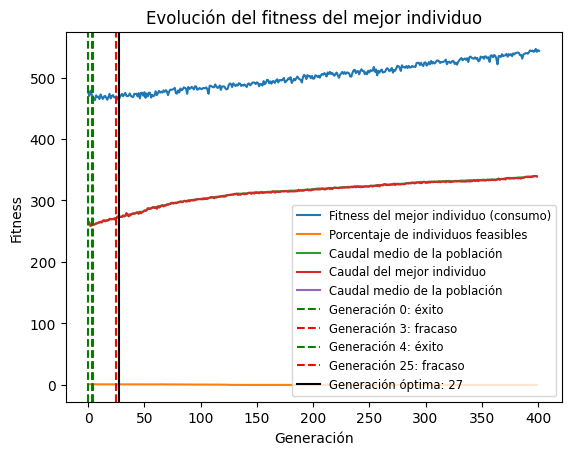

In [ ]:
# CRITERIO DE PARADA: N_GENERATIONS

# Inicializar población inicial semi-aleatoria
poblacion = poblacion_inicial(N_INDIVIDUOS, PRODUCCION, MIN_PRODUCCION)

# Inicializar resultados finales
best_individual = None
best_fitness = np.inf
evolucion = []
evol_perc_feasibles = []
evol_caudal_medio = []
best_caudal = []
busquedas_locales = []

# Evolucionar población
for gen in range(N_GENERATIONS):
    mejor_resultado, poblacion, perc_feasibles, caudal_medio, produccion_mejor_indiv, fitness_medio = evolve(poblacion, MIN_PRODUCCION, MUTATION_RATE)
    evolucion.append(mejor_resultado[0])
    evol_perc_feasibles.append(perc_feasibles)
    evol_caudal_medio.append(caudal_medio)
    best_caudal.append(produccion_mejor_indiv)

    if mejor_resultado[0] < best_fitness:
        best_fitness = mejor_resultado[0]
        best_individual = mejor_resultado[1]

        # Algoritmo memético: búsqueda local
        best_fitness, best_individual = busqueda_local(best_fitness, best_individual, step=0.5)
        if best_fitness < mejor_resultado[0]:
            print(f'Ha mejorado con la búsqueda local de {mejor_resultado[0]} a {best_fitness}')
            evolucion.append(best_fitness)
            busquedas_locales.append((gen, True))
        else:
            print('No ha mejorado con la búsqueda local')
            busquedas_locales.append((gen, False))
    
    if gen % 1 == 0:
        print(f'Generación {gen+1}: Mejor individuo: {best_individual}, Mejor fitness: {best_fitness}, Fitness medio: {fitness_medio}, Caudal del mejor: {produccion_mejor_indiv}, Caudal medio: {caudal_medio}')

print('\n', '-'*10, 'SOLUCIÓN FINAL', '-'*10)
print(f'Mejor individuo: {best_individual}, Mejor fitness (consumo total): {best_fitness}, Caudal: {produccion_mejor_indiv}')

generacion_optima = np.argmin(evolucion)
graficar_evolucion(evolucion, generacion_optima, busquedas_locales, evol_perc_feasibles, evol_caudal_medio, best_caudal, caudal_medio)

### MongoDB (parte 2/2): almacenamiento de resultados y queries

Los datos de los modelos de regresión ya se han almacenado. Se procede con los de optimización.

In [ ]:
dict_opt = {
    'params': {
        'pop_size': N_INDIVIDUOS,
        'n_generations': N_GENERATIONS,
        'mutation_rate': MUTATION_RATE,
        'crossover_rate': CROSSOVER_RATE
    },
    'results': {
        'n_generaciones': gen,
        'mejor_individuo': best_individual,
        'mejor_fitness': best_fitness,
        'caudal_del_mejor': produccion_mejor_indiv,
        'fitness_medio': fitness_medio,
        'caudal_medio': caudal_medio,
    }
}

In [ ]:
# Insertar en la colección de optimización de MongoDB
try:
    colec_opt.insert_one(dict_opt)
except pymongo.errors.DuplicateKeyError as error:
    print('Ya existe ese documento.')

print(db.list_collection_names()) # ahora ya aparecen las colecciones

['optimizacion', 'regresion']


In [ ]:
# Query 1: Contar los documentos donde el valor r2 sea mayor que 0.98:
query1 = colec_regr.count_documents({'metrics.r2': {'$gt': 0.98}})
print(f'Hay {query1} documentos con un coeficiente R2 superior a 0.98')

# Query 2: ¿En qué compresor se ha obtenido el mejor R2?
query2 = colec_regr.find().sort('metrics.r2', -1).limit(1)
for doc in query2:
    print(f'El mejor R2 se ha obtenido en el modelo del compresor {doc["compressor"]}: {doc["metrics"]["r2"]}')

# Query 3: ¿Y los errores más bajos?
query3 = colec_regr.find({'metrics.r2': {'$gt': 0.98}}).sort([('metrics.error_traintest', 1)]).limit(1)
for doc in query3:
    print(f'El error más bajo se ha obtenido en el compresor {doc["compressor"]}: error con train-test de {doc["metrics"]["error_traintest"]}')

# Query 4: Obtener los documentos donde la importancia de la característica 'Frecuencia' sea mayor que 90
query4 = colec_regr.find({"feature_importances.Frecuencia": {"$gt": 90}})
for doc in query4:
    print(f'La importancia de la característica Frecuencia es mayor a 90 ({doc["feature_importances"]["Frecuencia"]}) en el compresor {doc["compressor"]}')

# Query 5: Promedio de la importancia de la variable frecuencia para predecir la potencia
pipeline = [
    {"$group": {
        "_id": None, "avgFrecuenciaImportance": {"$avg": "$feature_importances.Frecuencia"}
    }}]
query5 = colec_regr.aggregate(pipeline)
for doc in query5:
    print(f'De media, la importancia de la variable Frecuencia para predecir la potencia es del {doc["avgFrecuenciaImportance"]:.2f}%')

Hay 4 documentos con un coeficiente R2 superior a 0.98
El mejor R2 se ha obtenido en el modelo del compresor CompB: 0.9948117581675736
El error más bajo se ha obtenido en el compresor CompB: error con train-test de 2.523313313924682
La importancia de la característica Frecuencia es mayor a 90 (90.32972632331904) en el compresor CompB
De media, la importancia de la variable Frecuencia para predecir la potencia es del 86.82%


In [ ]:
[*colec_opt.find()]

[{'_id': ObjectId('647b34adfff9f7e6e4708784'),
  'params': {'pop_size': 50,
   'n_generations': 400,
   'mutation_rate': 0.5,
   'crossover_rate': 0.8},
  'results': {'n_generaciones': 399,
   'mejor_individuo': [58.0, 39.0, 83.0, 76.0],
   'mejor_fitness': 471.00394374586824,
   'caudal_del_mejor': 608.8539126283982,
   'fitness_medio': 207159373.61737338,
   'caudal_medio': 611.1177859765407}}]

In [ ]:
[*colec_opt.find()]

# Queries

# Query 1: Obtener el mejor fitness de la colección de optimización
query1 = colec_opt.find_one({}, {'_id': 0, 'results.mejor_fitness': 1})
print(f'El mejor fitness ha sido: {query1["results"]["mejor_fitness"]}')

# Query 2: Obtener el mejor individuo de la colección de optimización
query2 = colec_opt.find_one({}, {'_id': 0, 'results.mejor_individuo': 1})
print(f'El mejor individuo tiene las siguientes frecuencias: {query2["results"]["mejor_individuo"]}')

El mejor fitness ha sido: 471.00394374586824
El mejor individuo tiene las siguientes frecuencias: [58.0, 39.0, 83.0, 76.0]
